## Evaluating the SLIC performance between different compositions (467 vs. PCA) using HoR.

In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from PIL import Image
import numpy as np
from skimage.segmentation import mark_boundaries

In [3]:
segments_467 = pd.read_csv('segments_467_all.csv')
segments_pca = pd.read_csv('segments_pca_all.csv')

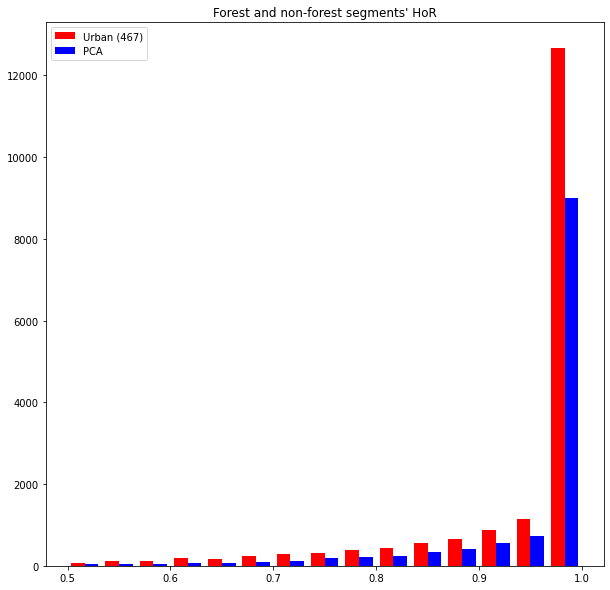

In [4]:
plt.figure(figsize=(10, 10))
plt.hist([segments_467['HoR'], segments_pca['HoR']], color=['r','b'], bins=15, label=['Urban (467)', 'PCA'])
plt.title("Forest and non-forest segments' HoR")
plt.legend(loc="upper left")

/tmp/ipykernel_32132/476756713.py:3: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  ax[0].hist([segments_467[segments_467['Class'] == 'forest']['HoR'], segments_pca[segments_467['Class'] == 'forest']['HoR']], color=['r','b'], bins=15, label=['Urban (467)', 'PCA'])
/tmp/ipykernel_32132/476756713.py:6: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  ax[1].hist([segments_467[segments_467['Class'] == 'non forest']['HoR'], segments_pca[segments_467['Class'] == 'non forest']['HoR']], color=['r','b'], bins=15, label=['Urban (467)', 'PCA'])


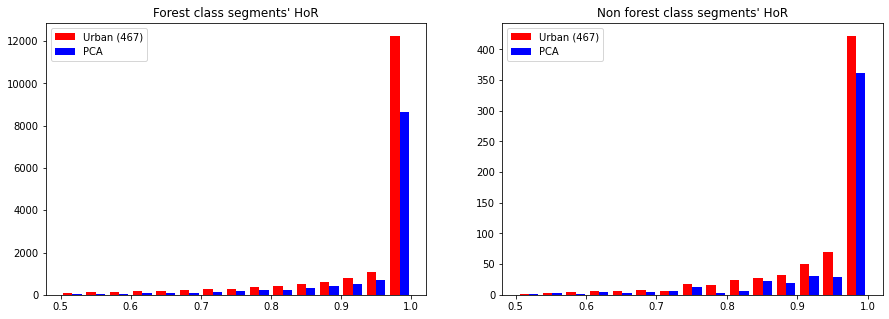

In [5]:
# forest class
fig, ax = plt.subplots(1, 2, figsize=(15, 5))
ax[0].hist([segments_467[segments_467['Class'] == 'forest']['HoR'], segments_pca[segments_467['Class'] == 'forest']['HoR']], color=['r','b'], bins=15, label=['Urban (467)', 'PCA'])
ax[0].set_title("Forest class segments' HoR")
ax[0].legend(loc="upper left")
ax[1].hist([segments_467[segments_467['Class'] == 'non forest']['HoR'], segments_pca[segments_467['Class'] == 'non forest']['HoR']], color=['r','b'], bins=15, label=['Urban (467)', 'PCA'])
ax[1].set_title("Non forest class segments' HoR")
ax[1].legend(loc="upper left")

### Segment count analysis

In [6]:
count_467 = segments_467['Region'].value_counts()
count_pca = segments_pca['Region'].value_counts()

count_df = pd.DataFrame({'467': count_467, 'PCA': count_pca})
count_df.append(count_df.sum().rename('Total'))

/tmp/ipykernel_32132/3319616956.py:5: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  count_df.append(count_df.sum().rename('Total'))


,467,PCA
x01,2766,1703
x02,1583,1280
x03,2002,1213
x04,779,518
x05,963,682
x06,1371,1213
x07,2480,2088
x08,2131,981
x09,2658,1615
x10,1465,897


In [7]:
count_df

,467,PCA
x01,2766,1703
x02,1583,1280
x03,2002,1213
x04,779,518
x05,963,682
x06,1371,1213
x07,2480,2088
x08,2131,981
x09,2658,1615
x10,1465,897


### Comparing segmentation between the two compositions

In [8]:
image_pca = Image.open('scenes_pca/pca_x01.png')
image_467 = Image.open('scenes_467/467_x01.png')
truth = np.load('truth_masks/truth_x01.npy')

In [9]:
alpha = np.where(truth == 2, 0, 255)

In [10]:
slic_pca = np.load('slics/slic_x01-pca.npy')
slic_467  = np.load('slics/slic_x01-467.npy')

In [11]:
print(f'Total number of segments (467): {len(np.unique(slic_467))}')
print(f'Total number of segments (PCA): {len(np.unique(slic_pca))}')

Total number of segments (467): 3920
Total number of segments (PCA): 3551


In [12]:
marked_pca = mark_boundaries(np.asarray(image_pca), slic_pca)
marked_467 = mark_boundaries(np.asarray(image_467), slic_467)

Text(0.5, 1.0, '467')

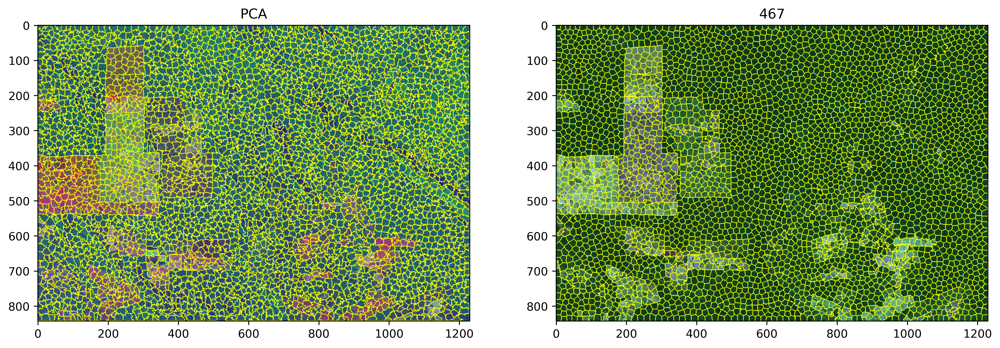

In [13]:
fig, ax = plt.subplots(1, 2, figsize=(15, 15), dpi=450)
ax[0].imshow(marked_pca)
ax[0].set_title('PCA')
ax[1].imshow(marked_467)
ax[1].set_title('467')

In [14]:
double_marked = mark_boundaries(marked_467, slic_pca, color=(1, 0, 0))

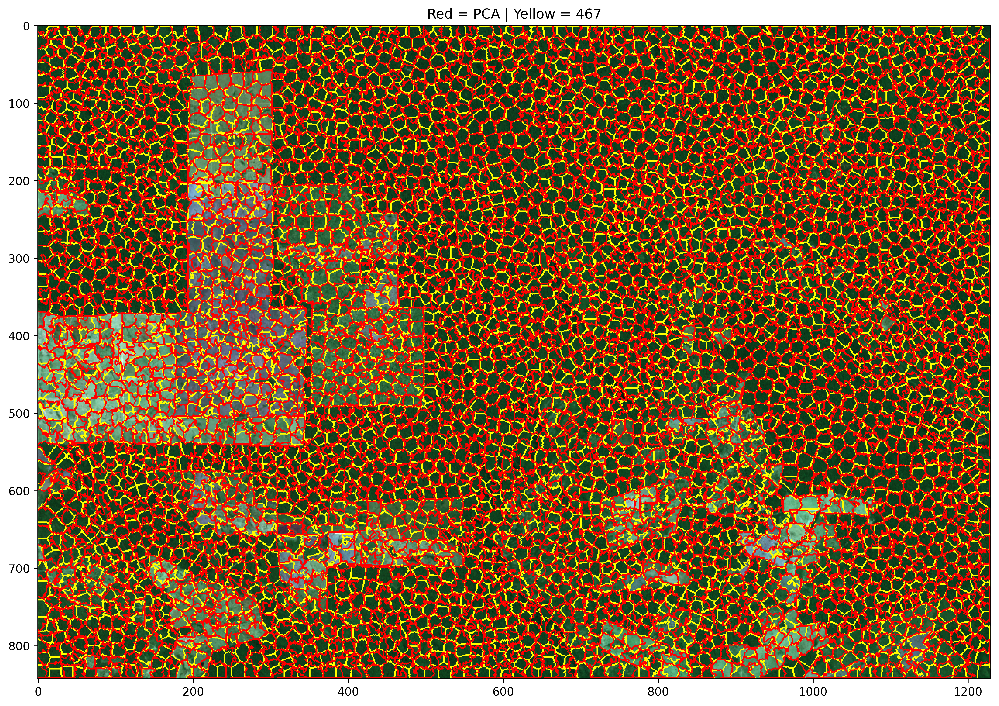

In [15]:
plt.figure(figsize=(15, 15), dpi=600)
plt.title("Red = PCA | Yellow = 467")
plt.imshow(double_marked)

In [16]:
image_467_np = np.asarray(image_467)
image_467_np = np.dstack((image_467_np, alpha))
image_467_np.shape

(843, 1230, 4)

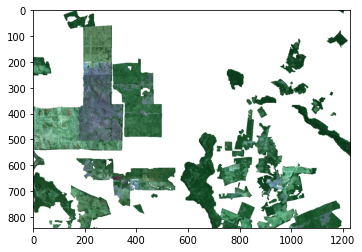

In [17]:
plt.imshow(image_467_np)

In [18]:
marked_467_np = np.asarray(marked_467)
marked_467_np = np.dstack((marked_467_np, alpha))
marked_467_np.shape

(843, 1230, 4)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


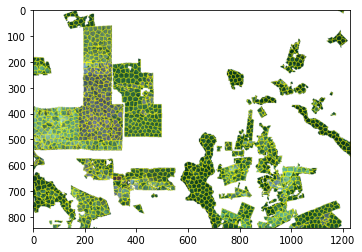

In [19]:
plt.imshow(marked_467_np)

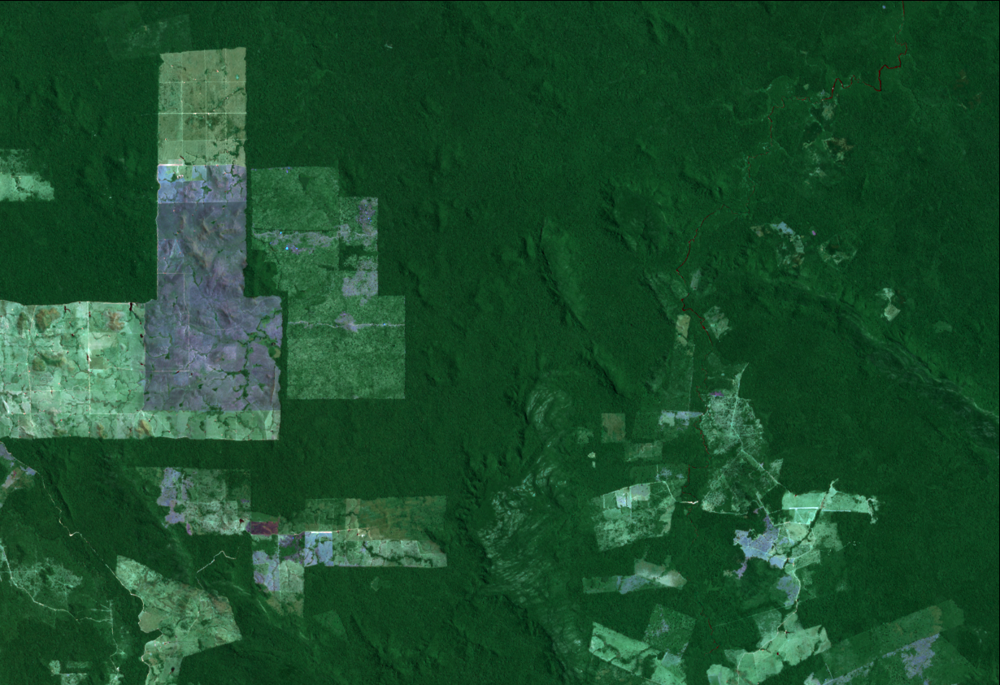

In [23]:
image_467

In [25]:
image_467.save('article_imgs/467_x01.png')

In [38]:
marked_467_pil = Image.fromarray(np.uint8(marked_467 * 255))
marked_467_pil.save('article_imgs/marked_467_x01.png')

In [34]:
rawSLIC = np.zeros(slic_467.shape + (3,), dtype=np.uint8)
rawSLIC = mark_boundaries(rawSLIC, slic_467)

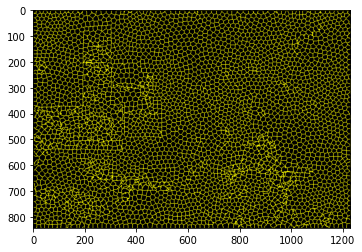

In [35]:
plt.imshow(rawSLIC)

In [39]:
rawSLIC_pil = Image.fromarray(np.uint8(rawSLIC * 255))
rawSLIC_pil.save('article_imgs/rawSLIC.png')

In [55]:
def band_norm(band):
    band_min, band_max = band.min(), band.max()
    return np.uint8((band - band_min) / (band_max - band_min))

In [56]:
slic_as_alpha = np.dstack((image_467, band_norm(slic_467)))

In [57]:
slic_as_alpha.dtype

dtype('uint8')

In [58]:
np.unique(slic_as_alpha)

array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,
        13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,
        26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,
        39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,
        52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,
        65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,
        78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,
        91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103,
       104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116,
       117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129,
       130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142,
       143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155,
       156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168,
       169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 18

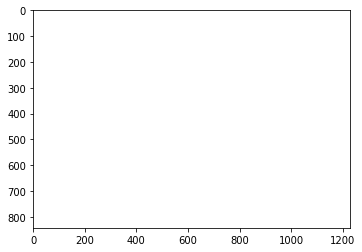

In [59]:
plt.imshow(slic_as_alpha)